In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
from surprise import Dataset
from surprise import Reader
from surprise.model_selection import train_test_split
from surprise import BaselineOnly, accuracy, Dataset, SVD, KNNBasic, Reader, NormalPredictor
from surprise.model_selection import cross_validate
from surprise.model_selection import KFold
from surprise.model_selection import PredefinedKFold
from surprise.model_selection import GridSearchCV
from sklearn.metrics.pairwise import cosine_similarity

movies = pd.read_csv(r"C:\Users\Helene\OneDrive\Documentos\WBS\WBSFLIX\movies.csv")
pd.set_option('display.max_columns', None)
movies.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [ ]:
links = pd.read_csv(r"C:\Users\Helene\OneDrive\Documentos\WBS\WBSFLIX\links.csv")
pd.set_option('display.max_columns', None)
links.head()

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0


In [ ]:
ratings = pd.read_csv(r"C:\Users\Helene\OneDrive\Documentos\WBS\WBSFLIX\ratings.csv")
pd.set_option('display.max_columns', None)
ratings.head()

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931


In [ ]:
tags = pd.read_csv(r"C:\Users\Helene\OneDrive\Documentos\WBS\WBSFLIX\tags.csv")
pd.set_option('display.max_columns', None)
tags.head()

,userId,movieId,tag,timestamp
0,2,60756,funny,1445714994
1,2,60756,Highly quotable,1445714996
2,2,60756,will ferrell,1445714992
3,2,89774,Boxing story,1445715207
4,2,89774,MMA,1445715200


In [ ]:
# Checking for missing values - This code only calculates missing values
# for the LINKS dataframe, since is the only one that presented missing values
missing_values_links = links.isnull().sum()

# Filter only columns with missing values
missing_columns_links = missing_values_links[missing_values_links > 0]

# Checking for duplicated rows
duplicated_rows_links = links.duplicated().sum()

print("Missing Values in movies:\n", missing_columns_links)
print("\nDuplicated Rows in movies:", duplicated_rows_links)

Missing Values in movies:
 tmdbId    8
dtype: int64

Duplicated Rows in movies: 0


In [ ]:
# Joining the movies dataframe with ratings dataframe
movie_ratings = movies.merge(ratings, how = "inner", on = "movieId")
movie_ratings.head()

,movieId,title,genres,userId,rating,timestamp
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1,4.0,964982703
1,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,5,4.0,847434962
2,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,7,4.5,1106635946
3,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,15,2.5,1510577970
4,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,17,4.5,1305696483


## Popularity Ranking

In [ ]:
# Highest-rated movies using popularity recommender
rating_count_df = movie_ratings.groupby('movieId')['rating'].agg(['mean', 'count']).reset_index()
rating_count_df.nlargest(10, ['mean', 'count'])

,movieId,mean,count
48,53,5.0,2
87,99,5.0,2
869,1151,5.0,2
2593,3473,5.0,2
4384,6442,5.0,2
4583,6818,5.0,2
7347,78836,5.0,2
121,148,5.0,1
405,467,5.0,1
432,495,5.0,1


In [ ]:
# Movie with highest mean score
highest_rating_id = rating_count_df.nlargest(1, 'mean')['movieId'].values[0]

highest_rated_id_mask = movie_ratings['movieId'] == highest_rating_id
movie_info_columns = ['movieId', 'title', 'genres'] #timestamp

movie_ratings.loc[highest_rated_id_mask, movie_info_columns].drop_duplicates()

,movieId,title,genres
2611,53,Lamerica (1994),Adventure|Drama


In [ ]:
# Most rated movies
rating_count_df.sort_values(by=['count', 'mean'], ascending=False).head()

,movieId,mean,count
314,356,4.164134,329
277,318,4.429022,317
257,296,4.197068,307
510,593,4.161290,279
1938,2571,4.192446,278


In [ ]:
# Movie with most reviews
most_rated_id = rating_count_df.nlargest(1, 'count')['movieId'].values[0]
most_rated_id_mask = movie_ratings['movieId'] == most_rated_id

movie_ratings.loc[most_rated_id_mask, movie_info_columns].drop_duplicates()

,movieId,title,genres
10019,356,Forrest Gump (1994),Comedy|Drama|Romance|War


In [ ]:
rating_count_df["hybrid"] = rating_count_df["mean"] * rating_count_df["count"]
rating_count_df.head(10)

,movieId,mean,count,hybrid
0,1,3.920930,215,843.0
1,2,3.431818,110,377.5
2,3,3.259615,52,169.5
3,4,2.357143,7,16.5
4,5,3.071429,49,150.5
5,6,3.946078,102,402.5
6,7,3.185185,54,172.0
7,8,2.875000,8,23.0
8,9,3.125000,16,50.0
9,10,3.496212,132,461.5


## User-based recommender
#### Working with the Surprise library

In [ ]:
!conda install -c conda-forge scikit-surprise -y

Solving environment: ...working... done

# All requested packages already installed.





==> WARNING: A newer version of conda exists. <==
  current version: 23.7.4
  latest version: 24.1.1

Please update conda by running

    $ conda update -n base -c defaults conda

Or to minimize the number of packages updated during conda update use

     conda install conda=24.1.1




In [ ]:
movie_users = movie_ratings[['userId', 'movieId', 'rating']]
movie_ratings.head()

,movieId,title,genres,userId,rating,timestamp
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1,4.0,964982703
1,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,5,4.0,847434962
2,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,7,4.5,1106635946
3,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,15,2.5,1510577970
4,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,17,4.5,1305696483


In [ ]:
# Creating a surprise dataset from the DataFrame
reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(movie_users, reader)# Splitting the dataset into train and test sets:
trainset, testset = train_test_split(data, test_size=0.2, random_state=142)

# Model to test
sim_options = {
    'name': 'cosine',
    'user_based': True
}

knn = KNNBasic(sim_options=sim_options)

# Training the algorithm on the training set:
knn.fit(trainset)

Computing the cosine similarity matrix...
Done computing similarity matrix.


In [ ]:
# Making predictions on the test set:
predictions = knn.test(testset)

# Exploring the predictions
predictions[:5]

[Prediction(uid=57, iid=3769, r_ui=4.0, est=3.0, details={'actual_k': 2, 'was_impossible': False}),
 Prediction(uid=313, iid=3535, r_ui=4.0, est=3.9119024871942027, details={'actual_k': 40, 'was_impossible': False}),
 Prediction(uid=334, iid=63082, r_ui=3.5, est=4.076402536445391, details={'actual_k': 40, 'was_impossible': False}),
 Prediction(uid=199, iid=2353, r_ui=2.0, est=3.4674790714071295, details={'actual_k': 40, 'was_impossible': False}),
 Prediction(uid=122, iid=5810, r_ui=4.5, est=3.115401227545727, details={'actual_k': 32, 'was_impossible': False})]

In [ ]:
# To enhance readability, convert this into a DataFrame, making it more
# visually appealing and easier to interpret.
predictions_df = pd.DataFrame(predictions, columns=["raw_user_id",
                                                    "raw_item_id",
                                                    "actual_user_rating",
                                                    "estimated_user_rating",
                                                    "details"]
                             )
predictions_df.head()

,raw_user_id,raw_item_id,actual_user_rating,estimated_user_rating,details
0,57,3769,4.0,3.000000,"{'actual_k': 2, 'was_impossible': False}"
1,313,3535,4.0,3.911902,"{'actual_k': 40, 'was_impossible': False}"
2,334,63082,3.5,4.076403,"{'actual_k': 40, 'was_impossible': False}"
3,199,2353,2.0,3.467479,"{'actual_k': 40, 'was_impossible': False}"
4,122,5810,4.5,3.115401,"{'actual_k': 32, 'was_impossible': False}"


In [ ]:
# Evaluating the model
# Mean Absolute Error
accuracy.mae(predictions)

# Root Mean Square Error
accuracy.rmse(predictions)

# Fraction of Concordant Pairs
accuracy.fcp(predictions)

MAE:  0.7469
RMSE: 0.9689
FCP:  0.6644


0.6644300285409351

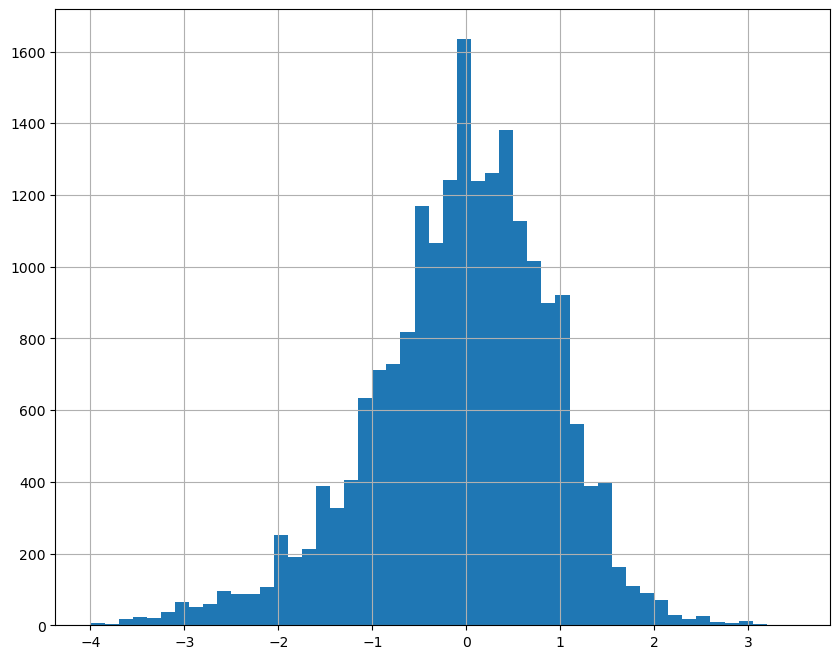

In [ ]:
# The manual approach - Histogram of errors
predictions_df["difference"] = predictions_df["actual_user_rating"] - predictions_df["estimated_user_rating"]

# Histogram of errors
predictions_df["difference"].hist(bins=50, figsize=(10, 8));

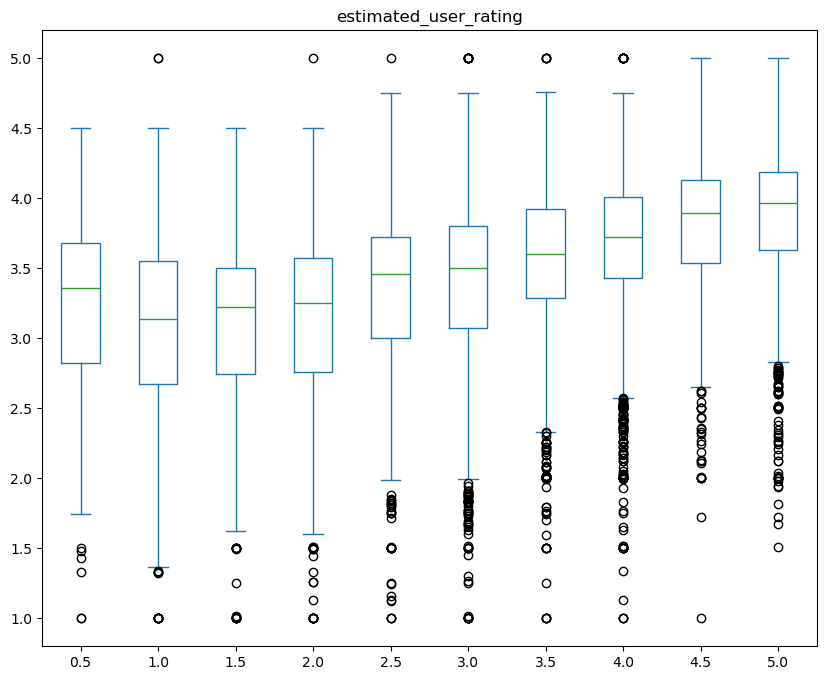

In [ ]:
# Boxplot of errors - manual error approach
predictions_df.plot(kind='box',
                    column='estimated_user_rating',
                    by='actual_user_rating',
                    figsize=(10, 8));

In [ ]:
# Creating a collaborative filtering model using the Surprise library

sim_options = {
    'name': 'cosine',
    'user_based': True
}

# Building the full_trainset
full_train = data.build_full_trainset()
algo = KNNBasic(sim_options=sim_options)
algo.fit(full_train)

Computing the cosine similarity matrix...
Done computing similarity matrix.


In [ ]:
# Building the full_trainset

testset = full_train.build_anti_testset()
predictions = algo.test(testset)
predictions = algo.test(testset)
testset[:5]

[(1, 2, 3.501556983616962),
 (1, 4, 3.501556983616962),
 (1, 5, 3.501556983616962),
 (1, 7, 3.501556983616962),
 (1, 8, 3.501556983616962)]

In [ ]:
# Creating a function that will provide the top n recommendations for a specified user

def get_top_n(testset, userId, n):
    # Filter the testset to include only rows with the specified user_id
    filtered_testset = [row for row in testset if row[0] == userId]

    # Make predictions on the filtered testset
    predictions = algo.test(filtered_testset)

    # Create a DataFrame from the predictions and return the top n predictions
    # based on the estimated ratings ('est')
    top_n_predictions_df = pd.DataFrame(predictions).nlargest(n, 'est')

    return top_n_predictions_df

# Check if the function works, test with the 50 top films
userId = 610
n = 50

top_n_df = get_top_n(testset, userId, n)
top_n_df

,uid,iid,r_ui,est,details
2696,610,3951,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
3014,610,4495,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
3437,610,5328,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
3477,610,5416,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
3831,610,6201,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
7224,610,109687,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
110,610,148,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
371,610,467,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
397,610,496,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"
488,610,626,3.501557,5.0,"{'actual_k': 1, 'was_impossible': False}"


In [ ]:
# Creating a DataFrame from the top_n with columns 'movieId' and 'estimated_rating'
reduced_top_n_df = top_n_df.loc[:, ["iid", "est"]].rename(columns={"iid": "movieId", "est": "estimated_rating"})

# Creating a copy of the original DataFrame with duplicate 'movieId' entries removed
reduced__original_df = movie_ratings.drop_duplicates(subset='movieId').copy()

# Merging the 2 created DataFrames based on 'movieId', retaining only the matching rows
merged_df = reduced_top_n_df.merge(reduced__original_df, on="movieId", how='left')

# Selecting specific columns from the merged DataFrame to include in the final result
final_df = merged_df[['movieId', 'title', 'genres', 'estimated_rating']]

final_df

,movieId,title,genres,estimated_rating
0,3951,Two Family House (2000),Drama,5.0
1,4495,Crossing Delancey (1988),Comedy|Romance,5.0
2,5328,Rain (2001),Drama|Romance,5.0
3,5416,Cherish (2002),Comedy|Drama|Thriller,5.0
4,6201,Lady Jane (1986),Drama|Romance,5.0
5,109687,Particle Fever (2013),Documentary,5.0
6,148,"Awfully Big Adventure, An (1995)",Drama,5.0
7,467,Live Nude Girls (1995),Comedy,5.0
8,496,What Happened Was... (1994),Comedy|Drama|Romance|Thriller,5.0
9,626,"Thin Line Between Love and Hate, A (1996)",Comedy,5.0


In [ ]:
# Merge the dataframes merged_df and links to have the correct result to download to Streamlit
merged_df = final_df.merge(links, on="movieId", how="left")
merged_df

,movieId,title,genres,estimated_rating,imdbId,tmdbId
0,3951,Two Family House (2000),Drama,5.0,202641,63956.0
1,4495,Crossing Delancey (1988),Comedy|Romance,5.0,94921,27397.0
2,5328,Rain (2001),Drama|Romance,5.0,287645,69324.0
3,5416,Cherish (2002),Comedy|Drama|Thriller,5.0,298798,18408.0
4,6201,Lady Jane (1986),Drama|Romance,5.0,91374,21867.0
5,109687,Particle Fever (2013),Documentary,5.0,1385956,202141.0
6,148,"Awfully Big Adventure, An (1995)",Drama,5.0,112427,22279.0
7,467,Live Nude Girls (1995),Comedy,5.0,113674,26271.0
8,496,What Happened Was... (1994),Comedy|Drama|Romance|Thriller,5.0,111689,83718.0
9,626,"Thin Line Between Love and Hate, A (1996)",Comedy,5.0,117891,28121.0


## Item based recommender

In item-based recommendation systems, the similarity between items is a fundamental measure to identify which items are similar to each other. Two common techniques for calculating this similarity are cosine similarity and Pearson correlation.

### Pearson correlation metrix

- Pearson correlation is a statistical measure that evaluates the linear relationship between two sets of data, in this case, the ratings of two items, being sensitive to the scale of the data and can be affected by extreme values (outliers), therefore, it is important to normalize data before calculating the correlation
- Unlike cosine similarity, which only considers the direction of vectors, Pearson correlation also takes into account the magnitude of vectors
- A Pearson correlation of 1 indicates a perfect positive correlation, -1 indicates a perfect negative correlation, and 0 indicates no linear correlation between items

In [ ]:
# User item matrix
user_matrix = pd.pivot_table(data=movie_ratings,
                                  values='rating',
                                  index='userId',
                                  columns='movieId',
                                  fill_value=0)
user_matrix.head(30)

movieId  1       2       3       4       5       6       7       8       \
userId                                                                    
1           4.0     0.0     4.0     0.0     0.0     4.0     0.0     0.0   
2           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
3           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
4           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
5           4.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
6           0.0     4.0     5.0     3.0     5.0     4.0     4.0     3.0   
7           4.5     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
8           0.0     4.0     0.0     0.0     0.0     0.0     0.0     0.0   
9           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
10          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
11          0.0     0.0     0.0     0.0     0.0     5.0     0.0     0.0   
12          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
13          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
14          0.0     0.0     0.0     3.0     0.0     0.0     3.0     0.0   
15          2.5     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
16          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
17          4.5     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
18          3.5     3.0     0.0     0.0     0.0     4.0     0.0     0.0   
19          4.0     3.0     3.0     0.0     0.0     0.0     2.0     0.0   
20          0.0     3.0     0.0     0.0     0.0     0.0     0.0     1.0   
21          3.5     3.5     0.0     0.0     0.0     0.0     0.0     0.0   
22          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
23          0.0     0.0     0.0     0.0     0.0     4.0     0.0     0.0   
24          0.0     0.0     0.0     0.0     0.0     4.5     0.0     0.0   
25          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
26          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
27          3.0     4.0     0.0     0.0     0.0     0.0     0.0     0.0   
28          0.0     0.0     0.0     0.0     0.0     3.5     0.0     0.0   
29          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
30          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   

movieId  9       10      11      12      13      14      15      16      \
userId                                                                    
1           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
2           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
3           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
4           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
5           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
6           0.0     3.0     4.0     0.0     3.0     0.0     4.0     4.0   
7           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
8           0.0     2.0     4.0     0.0     0.0     0.0     0.0     0.0   
9           0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
10          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
11          0.0     3.0     0.0     0.0     0.0     0.0     0.0     0.0   
12          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
13          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
14          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
15          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
16          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
17          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
18          0.0     0.0     0.0     0.0     0.0     0.0     0.0     4.5   
19          0.0     2.0     0.0     1.0     3.0     0.0     2.0     0.0   
20          0.0     0.0 

In [ ]:
## Pearson correlation metrix
correlations_matrix = user_matrix.corr()
correlations_matrix

movieId    1         2         3         4         5         6         7       \
movieId                                                                         
1        1.000000  0.231327  0.173213 -0.028917  0.192474  0.192686  0.143743   
2        0.231327  1.000000  0.191945  0.071269  0.200526  0.158341  0.127569   
3        0.173213  0.191945  1.000000  0.067143  0.370171  0.196442  0.351513   
4       -0.028917  0.071269  0.067143  1.000000  0.167910  0.053755  0.258075   
5        0.192474  0.200526  0.370171  0.167910  1.000000  0.215503  0.429890   
...           ...       ...       ...       ...       ...       ...       ...   
193581  -0.028906 -0.018291 -0.011729 -0.004138 -0.011456 -0.017712 -0.012033   
193583  -0.028906 -0.018291 -0.011729 -0.004138 -0.011456 -0.017712 -0.012033   
193585  -0.028906 -0.018291 -0.011729 -0.004138 -0.011456 -0.017712 -0.012033   
193587  -0.028906 -0.018291 -0.011729 -0.004138 -0.011456 -0.017712 -0.012033   
193609  -0.028906 -0.018291 -0.011729 -0.004138 -0.011456 -0.017712 -0.012033   

movieId    8         9         10        11        12        13        14      \
movieId                                                                         
1        0.085477  0.177245  0.183382  0.172799  0.159352  0.106217  0.099645   
2        0.141540 -0.021045  0.285086  0.217090  0.115290  0.163556  0.033185   
3        0.296897  0.275812  0.136916  0.174251  0.168038  0.118157  0.136819   
4        0.148726 -0.016025  0.056000  0.128247 -0.016306  0.142266  0.095113   
5        0.265777  0.308085  0.110833  0.201002  0.173630  0.089913  0.220718   
...           ...       ...       ...       ...       ...       ...       ...   
193581  -0.004383 -0.006359 -0.020524 -0.014124 -0.006471 -0.004587 -0.006952   
193583  -0.004383 -0.006359 -0.020524 -0.014124 -0.006471 -0.004587 -0.006952   
193585  -0.004383 -0.006359 -0.020524 -0.014124 -0.006471 -0.004587 -0.006952   
193587  -0.004383 -0.006359 -0.020524 -0.014124 -0.006471 -0.004587 -0.006952   
193609  -0.004383 -0.006359  0.060859 -0.014124 -0.006471 -0.004587 -0.006952   

movieId    15        16        17        18        19        20        21      \
movieId                                                                         
1        0.031566  0.111011  0.194823  0.082023  0.233791  0.076863  0.158697   
2        0.191785  0.108676  0.089893  0.122904  0.412808  0.077238  0.142614   
3        0.111644  0.216929  0.139433  0.159748  0.201430  0.056939  0.223468   
4        0.145606  0.082152  0.216735 -0.018267  0.041741 -0.015134  0.099788   
5        0.070170  0.108118  0.208128  0.190412  0.205252  0.012445  0.138687   
...           ...       ...       ...       ...       ...       ...       ...   
193581  -0.005569 -0.015525 -0.013560 -0.007249 -0.015344 -0.006006 -0.016181   
193583  -0.005569 -0.015525 -0.013560 -0.007249 -0.015344 -0.006006 -0.016181   
193585  -0.005569 -0.015525 -0.013560 -0.007249 -0.015344 -0.006006 -0.016181   
193587  -0.005569 -0.015525 -0.013560 -0.007249 -0.015344 -0.006006 -0.016181   
193609  -0.005569 -0.015525 -0.013560 -0.007249 -0.015344 -0.006006 -0.016181   

movieId    22        23        24        25        26        27        28      \
movieId                                                                         
1        0.113459  0.094164  0.121251  0.167119  0.107887  0.049394  0.059213   
2        0.166453  0.072982  0.134440  0.024450  0.114487  0.114544  0.053300   
3        0.199207  0.114876  0.249312  0.133807  0.166889  0.234879  0.062243   
4        0.140905 -0.015813  0.113645  0.155000  0.166199  0.119322  0.040526   
5        0.162527  0.128338  0.190889  0.218139  0.186933  0.259175  0.001734   
...           ...       ...       ...       ...       ...       ...       ...   
193581  -0.009822 -0.006275 -0.008449 -0.014529 -0.005895 -0.004692 -0.005405   
193583  -0.009822 -0.006275 -0.008449 -0.014529 -0.005895 -0.004692 -0.005405   
193585  -0.009822 -0.006275 

In [ ]:
# Highest scoring movie - most rated
most_rated_id = rating_count_df.nlargest(1, 'count')['movieId'].values[0]
most_rated_id_mask = movie_ratings['movieId'] == most_rated_id

movie_ratings.loc[most_rated_id_mask, movie_info_columns].drop_duplicates()

,movieId,title,genres
10019,356,Forrest Gump (1994),Comedy|Drama|Romance|War


In [ ]:
# Find the Id for Forrest Gump
forest_gump_title_mask = movie_ratings["title"].str.contains('Forrest Gump', case=False)
forest_gump_genre_mask = movie_ratings["genres"].str.contains('Comedy|Drama|Romance|War', case=False)
forest_gump_id = movie_ratings.loc[forest_gump_title_mask & forest_gump_genre_mask, "movieId"].values[0]

# Select the column, from the above matrix, matching the Id of The Lovely Bones
forest_gump_correl_df = pd.DataFrame(correlations_matrix[forest_gump_id])
forest_gump_correl_df.head()

,356
movieId,
1,0.228127
2,0.255733
3,0.090639
4,0.102824
5,0.064031


In [ ]:
# Making column title more explanatory
forest_gump_correl_df = forest_gump_correl_df.rename(columns={forest_gump_id: 'forest_gump_correl'})
forest_gump_correl_df.head()

,forest_gump_correl
movieId,
1,0.228127
2,0.255733
3,0.090639
4,0.102824
5,0.064031


In [ ]:
# Removing the correlation of Forest_Gump to itself
forest_gump_correl_df = forest_gump_correl_df[forest_gump_correl_df.index != forest_gump_id]
forest_gump_correl_df .head()

,forest_gump_correl
movieId,
1,0.228127
2,0.255733
3,0.090639
4,0.102824
5,0.064031


In [ ]:
# Ordering the correlations descendingly and looking at the top 10
forest_gump_correl_df = forest_gump_correl_df.sort_values(by="forest_gump_correl", ascending=False)
forest_gump_correl_df.head(10)

,forest_gump_correl
movieId,
480,0.453632
500,0.440460
318,0.411180
150,0.390374
597,0.390179
110,0.374274
296,0.373776
364,0.358141
377,0.348109


In [ ]:
# Calculating the number of users who rated multiple movies
num_users_rated_many_movies = [sum((user_matrix[forest_gump_id] > 0) & (user_matrix[id] > 0)) for id in forest_gump_correl_df.index]

forest_gump_correl_df['users_who_rated_many_movies'] = num_users_rated_many_movies

forest_gump_correl_df.head(10)

,forest_gump_correl,users_who_rated_many_movies
movieId,,
480,0.453632,198
500,0.440460,135
318,0.411180,231
150,0.390374,165
597,0.390179,125
110,0.374274,183
296,0.373776,230
364,0.358141,144
377,0.348109,145


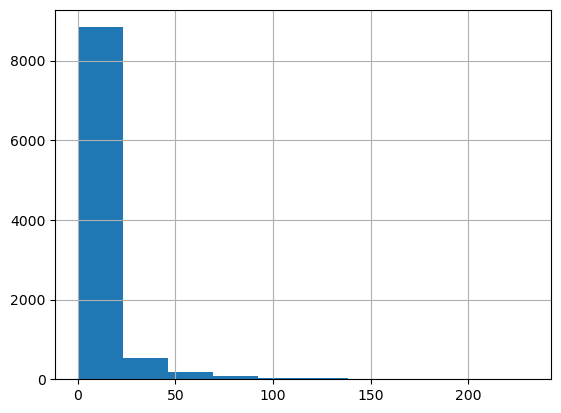

In [ ]:
forest_gump_correl_df['users_who_rated_many_movies'].hist();

In [ ]:
forest_gump_correl_df = forest_gump_correl_df[forest_gump_correl_df["users_who_rated_many_movies"] > 10]

# Adding the movies titles and authors to see what our results are
movie_info_columns = ['movieId', 'title', 'genres']

forest_gump_top_10_correl = (forest_gump_correl_df
                                  .head(10)
                                  .reset_index()
                                  .merge(movie_ratings.drop_duplicates(subset='movieId'),
                                         on='movieId',
                                         how='left')
                                  [movie_info_columns + ['forest_gump_correl',	'users_who_rated_many_movies']]
                                  )
forest_gump_top_10_correl

,movieId,title,genres,forest_gump_correl,users_who_rated_many_movies
0,480,Jurassic Park (1993),Action|Adventure|Sci-Fi|Thriller,0.453632,198
1,500,Mrs. Doubtfire (1993),Comedy|Drama,0.440460,135
2,318,"Shawshank Redemption, The (1994)",Crime|Drama,0.411180,231
3,150,Apollo 13 (1995),Adventure|Drama|IMAX,0.390374,165
4,597,Pretty Woman (1990),Comedy|Romance,0.390179,125
5,110,Braveheart (1995),Action|Drama|War,0.374274,183
6,296,Pulp Fiction (1994),Comedy|Crime|Drama|Thriller,0.373776,230
7,364,"Lion King, The (1994)",Adventure|Animation|Children|Drama|Musical|IMAX,0.358141,144
8,377,Speed (1994),Action|Romance|Thriller,0.348109,145
9,586,Home Alone (1990),Children|Comedy,0.342296,104


In [ ]:
movie_ratings.loc[forest_gump_genre_mask, movie_info_columns].drop_duplicates()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
325,3,Grumpier Old Men (1995),Comedy|Romance
377,4,Waiting to Exhale (1995),Comedy|Drama|Romance
384,5,Father of the Bride Part II (1995),Comedy
535,7,Sabrina (1995),Comedy|Romance
...,...,...,...
100828,193571,Silver Spoon (2014),Comedy|Drama
100831,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy
100832,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy
100833,193585,Flint (2017),Drama


### Cosine similarity correlation matrix

- Cosine similarity is a measure that quantifies the similarity between two vectors, representing items, in multidimensional space. Measures the cosine of the angle between these vectors, the closer the vectors are in direction, the greater the cosine similarity
- In the context of recommendation systems, items are represented as vectors, where each dimension corresponds to a characteristic (for example, the rating given by users)
- Cosine similarity ranges from -1 to 1, where 1 indicates that the items are identical, -1 indicates that they are completely opposite, and 0 indicates that they are orthogonal (unrelated)

In [ ]:
# Cosine similarity correlation matrix
cosine_similarity(user_matrix.T)

array([[1.        , 0.41056206, 0.2969169 , ..., 0.        , 0.        ,
        0.        ],
       [0.41056206, 1.        , 0.28243799, ..., 0.        , 0.        ,
        0.        ],
       [0.2969169 , 0.28243799, 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 1.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

In [ ]:
# Cosine similarity correlation matrix
cosines_matrix = pd.DataFrame(cosine_similarity(user_matrix.T),
                                    columns=user_matrix.columns,
                                    index=user_matrix.columns)
cosines_matrix

movieId    1         2         3         4         5         6         7       \
movieId                                                                         
1        1.000000  0.410562  0.296917  0.035573  0.308762  0.376316  0.277491   
2        0.410562  1.000000  0.282438  0.106415  0.287795  0.297009  0.228576   
3        0.296917  0.282438  1.000000  0.092406  0.417802  0.284257  0.402831   
4        0.035573  0.106415  0.092406  1.000000  0.188376  0.089685  0.275035   
5        0.308762  0.287795  0.417802  0.188376  1.000000  0.298969  0.474002   
...           ...       ...       ...       ...       ...       ...       ...   
193581   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193583   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193585   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193587   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193609   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   

movieId    8         9         10        11        12        13        14      \
movieId                                                                         
1        0.131629  0.232586  0.395573  0.323976  0.219680  0.151236  0.178144   
2        0.172498  0.044835  0.417693  0.322252  0.168642  0.194398  0.099373   
3        0.313434  0.304840  0.242954  0.249568  0.203237  0.144049  0.176544   
4        0.158022  0.000000  0.095598  0.153910  0.000000  0.152057  0.110435   
5        0.283523  0.335058  0.218061  0.272182  0.207889  0.116569  0.255333   
...           ...       ...       ...       ...       ...       ...       ...   
193581   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193583   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193585   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193587   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193609   0.000000  0.000000  0.072542  0.000000  0.000000  0.000000  0.000000   

movieId    15        16        17        18        19        20        21      \
movieId                                                                         
1        0.104528  0.292152  0.334693  0.167993  0.383641  0.147039  0.335337   
2        0.229191  0.239683  0.208254  0.182717  0.497560  0.129955  0.273282   
3        0.144100  0.294055  0.215245  0.200013  0.279409  0.094867  0.302458   
4        0.157336  0.112660  0.236706  0.000000  0.074807  0.000000  0.129864   
5        0.103934  0.194478  0.276254  0.228271  0.281046  0.051730  0.224821   
...           ...       ...       ...       ...       ...       ...       ...   
193581   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193583   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193585   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193587   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193609   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   

movieId    22        23        24        25        26        27        28      \
movieId                                                                         
1        0.226570  0.164626  0.215168  0.324072  0.170520  0.106747  0.124567   
2        0.244361  0.128695  0.203931  0.159834  0.162491  0.151033  0.102551   
3        0.251466  0.151596  0.291192  0.214832  0.198667  0.256104  0.096027   
4        0.160161  0.000000  0.131412  0.179436  0.178241  0.129602  0.053394   
5        0.216080  0.163674  0.235350  0.289412  0.217173  0.279038  0.037623   
...           ...       ...       ...       ...       ...       ...       ...   
193581   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193583   0.000000  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
193585   0.000000  0.000000 

In [ ]:
# Finding movies similar to the most popular movie - Forrest Gump
# Creating a DataFrame using the values from 'cosines_matrix' for the 'forrest_gump_id' movie.
forest_gump_cosines_df = pd.DataFrame(cosines_matrix[forest_gump_id])

# Renaming the column 'forest_gump_id' to 'forest_gump_cosine'
forest_gump_cosines_df = forest_gump_cosines_df.rename(columns={forest_gump_id: 'forest_gump_cosine'})

# Removing the row with the index 'forest_gump_id'
forest_gump_cosines_df  = forest_gump_cosines_df [forest_gump_cosines_df .index != forest_gump_id]

# Sorting the 'forest_gump_cosines_df' by the column 'forest_gump_cosines' column in descending order.
forest_gump_cosines_df= forest_gump_cosines_df.sort_values(by="forest_gump_cosine", ascending=False)

# Finding out the number of users rated both Forrest Gump and the other movie
no_of_users_rated_many_books = [sum((user_matrix[forest_gump_id] > 0) & (user_matrix[id] > 0)) for id in forest_gump_cosines_df.index]

# Creating a column for the number of users who rated The Forest_gump and the other movie
forest_gump_cosines_df['users_who_rated_many_books'] = no_of_users_rated_many_books

# Removing recommendations that have less than 10 users who rated both movies.
forest_gump_cosines_df = forest_gump_cosines_df[forest_gump_cosines_df["users_who_rated_many_books"] > 10]

# Displaying the first 10 rows of the 'forest_gump_cosines_df' DataFrame.
forest_gump_cosines_df.head(10)

,forest_gump_cosine,users_who_rated_many_books
movieId,,
318,0.712993,231
480,0.688259,198
296,0.685544,230
110,0.643090,183
593,0.639463,199
150,0.627559,165
2571,0.609935,194
500,0.607983,135
527,0.602072,164


In [ ]:
# Adding the titles and authors to the top 10
forest_gump_top_50_cosine = (forest_gump_cosines_df
                              .head(50)
                              .reset_index()
                              .merge(movie_ratings.drop_duplicates(subset='movieId'),
                                     on='movieId',
                                     how='left')
                              [movie_info_columns + ['forest_gump_cosine',	'users_who_rated_many_books']]
                              )
forest_gump_top_50_cosine

,movieId,title,genres,forest_gump_cosine,users_who_rated_many_books
0,318,"Shawshank Redemption, The (1994)",Crime|Drama,0.712993,231
1,480,Jurassic Park (1993),Action|Adventure|Sci-Fi|Thriller,0.688259,198
2,296,Pulp Fiction (1994),Comedy|Crime|Drama|Thriller,0.685544,230
3,110,Braveheart (1995),Action|Drama|War,0.643090,183
4,593,"Silence of the Lambs, The (1991)",Crime|Horror|Thriller,0.639463,199
5,150,Apollo 13 (1995),Adventure|Drama|IMAX,0.627559,165
6,2571,"Matrix, The (1999)",Action|Sci-Fi|Thriller,0.609935,194
7,500,Mrs. Doubtfire (1993),Comedy|Drama,0.607983,135
8,527,Schindler's List (1993),Drama|War,0.602072,164
9,589,Terminator 2: Judgment Day (1991),Action|Sci-Fi,0.600886,170


In [ ]:
merged_cosine = pd.merge(forest_gump_top_50_cosine, links, on='movieId', how='inner')
merged_cosine.head()

,movieId,title,genres,forest_gump_cosine,users_who_rated_many_books,imdbId,tmdbId
0,318,"Shawshank Redemption, The (1994)",Crime|Drama,0.712993,231,111161,278.0
1,480,Jurassic Park (1993),Action|Adventure|Sci-Fi|Thriller,0.688259,198,107290,329.0
2,296,Pulp Fiction (1994),Comedy|Crime|Drama|Thriller,0.685544,230,110912,680.0
3,110,Braveheart (1995),Action|Drama|War,0.643090,183,112573,197.0
4,593,"Silence of the Lambs, The (1991)",Crime|Horror|Thriller,0.639463,199,102926,274.0
